# Import necessary libraries

In [1]:
import warnings 
warnings.filterwarnings('ignore')

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision.models as models
import numpy as np
import os
import time
import random
import cv2
from PIL import Image
import pywt
from matplotlib import pyplot as plt
import math

## Set random seed for reproducibility

In [3]:
seed = 732681
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

## Check if CUDA is available

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


# Defining Parts of Model

## Define the ResNet block for the Generator

In [5]:
class ResnetBlock(nn.Module):
    def __init__(self, dim, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_bias=True):
        super(ResnetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_bias)
        
    def build_conv_block(self, dim, padding_type, norm_layer, use_bias):
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)
            
        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim),
            nn.ReLU(True)
        ]
        
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
            
        conv_block += [
            nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias),
            norm_layer(dim)
        ]
            
        return nn.Sequential(*conv_block)
    
    def forward(self, x):
        return x + self.conv_block(x)

## RRDB Block for Enhanced Generator

In [6]:
class RRDBBlock(nn.Module):
    def __init__(self, nf, gc=32, residual_scalar=0.2):
        super(RRDBBlock, self).__init__()
        self.residual_scalar = residual_scalar
        
        # Dense block 1
        self.conv1 = nn.Conv2d(nf, gc, 3, 1, 1, bias=True)
        self.conv2 = nn.Conv2d(nf + gc, gc, 3, 1, 1, bias=True)
        self.conv3 = nn.Conv2d(nf + 2 * gc, gc, 3, 1, 1, bias=True)
        self.conv4 = nn.Conv2d(nf + 3 * gc, gc, 3, 1, 1, bias=True)
        self.conv5 = nn.Conv2d(nf + 4 * gc, nf, 3, 1, 1, bias=True)
        
        # Dense block 2
        self.conv6 = nn.Conv2d(nf, gc, 3, 1, 1, bias=True)
        self.conv7 = nn.Conv2d(nf + gc, gc, 3, 1, 1, bias=True)
        self.conv8 = nn.Conv2d(nf + 2 * gc, gc, 3, 1, 1, bias=True)
        self.conv9 = nn.Conv2d(nf + 3 * gc, gc, 3, 1, 1, bias=True)
        self.conv10 = nn.Conv2d(nf + 4 * gc, nf, 3, 1, 1, bias=True)
        
        # Dense block 3
        self.conv11 = nn.Conv2d(nf, gc, 3, 1, 1, bias=True)
        self.conv12 = nn.Conv2d(nf + gc, gc, 3, 1, 1, bias=True)
        self.conv13 = nn.Conv2d(nf + 2 * gc, gc, 3, 1, 1, bias=True)
        self.conv14 = nn.Conv2d(nf + 3 * gc, gc, 3, 1, 1, bias=True)
        self.conv15 = nn.Conv2d(nf + 4 * gc, nf, 3, 1, 1, bias=True)
        
        self.lrelu = nn.LeakyReLU(0.2, inplace=True)
    
    def forward(self, x):
        # Dense block 1
        x1 = self.lrelu(self.conv1(x))
        x1_cat = torch.cat((x, x1), 1)
        x2 = self.lrelu(self.conv2(x1_cat))
        x2_cat = torch.cat((x, x1, x2), 1)  # Correct concatenation
        x3 = self.lrelu(self.conv3(x2_cat))
        x3_cat = torch.cat((x, x1, x2, x3), 1)  # Correct concatenation
        x4 = self.lrelu(self.conv4(x3_cat))
        x4_cat = torch.cat((x, x1, x2, x3, x4), 1)  # Correct concatenation
        x5 = self.conv5(x4_cat)
        x1 = x5 * self.residual_scalar + x
        
        # Dense block 2
        x2 = self.lrelu(self.conv6(x1))
        x2_cat = torch.cat((x1, x2), 1)
        x3 = self.lrelu(self.conv7(x2_cat))
        x3_cat = torch.cat((x1, x2, x3), 1)  # Correct concatenation
        x4 = self.lrelu(self.conv8(x3_cat))
        x4_cat = torch.cat((x1, x2, x3, x4), 1)  # Correct concatenation
        x5 = self.lrelu(self.conv9(x4_cat))
        x5_cat = torch.cat((x1, x2, x3, x4, x5), 1)  # Correct concatenation
        x6 = self.conv10(x5_cat)
        x2 = x6 * self.residual_scalar + x1
        
        # Dense block 3
        x3 = self.lrelu(self.conv11(x2))
        x3_cat = torch.cat((x2, x3), 1)
        x4 = self.lrelu(self.conv12(x3_cat))
        x4_cat = torch.cat((x2, x3, x4), 1)  # Correct concatenation
        x5 = self.lrelu(self.conv13(x4_cat))
        x5_cat = torch.cat((x2, x3, x4, x5), 1)  # Correct concatenation
        x6 = self.lrelu(self.conv14(x5_cat))
        x6_cat = torch.cat((x2, x3, x4, x5, x6), 1)  # Correct concatenation
        x7 = self.conv15(x6_cat)
        x3 = x7 * self.residual_scalar + x2
        
        return x3 * self.residual_scalar + x

## ESRGAN-Based Upscaler Implementation

In [7]:
class ESRGANUpscaler(nn.Module):
    def __init__(self, scale_factor=4, in_channels=3, out_channels=3, nf=64, gc=32):
        super(ESRGANUpscaler, self).__init__()
        
        # Initial convolution
        self.conv_first = nn.Conv2d(in_channels, nf, kernel_size=3, stride=1, padding=1)
        
        # RRDB blocks
        self.rrdb_blocks = nn.Sequential(*[RRDBBlock(nf, gc) for _ in range(23)])
        self.conv_body = nn.Conv2d(nf, nf, kernel_size=3, stride=1, padding=1)
        
        # Upsampling blocks
        self.upsampling = nn.Sequential()
        for i in range(int(math.log(scale_factor, 2))):
            self.upsampling.add_module(f'up{i+1}', nn.Conv2d(nf, nf * 4, kernel_size=3, padding=1))
            self.upsampling.add_module(f'pixelshuffle{i+1}', nn.PixelShuffle(2))
            self.upsampling.add_module(f'lrelu{i+1}', nn.LeakyReLU(0.2, inplace=True))
        
        # Final output layer
        self.conv_last = nn.Conv2d(nf, out_channels, kernel_size=3, padding=1)
        
        # Initialize weights
        self._initialize_weights()
        
    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        feat = self.conv_first(x)
        body_feat = self.rrdb_blocks(feat)
        body_feat = self.conv_body(body_feat)
        feat = feat + body_feat
        feat = self.upsampling(feat)
        out = self.conv_last(feat)
        return out

## Define the ArtResGenerator

In [8]:
class ArtResGenerator(nn.Module):
    def __init__(self, input_nc=9, output_nc=3, ngf=64, norm_layer=nn.InstanceNorm2d, 
                 use_dropout=False, n_blocks=6, padding_type='reflect', scale_factor=1):
        super(ArtResGenerator, self).__init__()
        
        # Initial convolution block - now accepting 9 channels (3 original + 6 enhanced)
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=True),
            norm_layer(ngf),
            nn.ReLU(True)
        ]
        
        # Downsampling
        n_downsampling = 4
        for i in range(n_downsampling):
            mult = 2**i
            model += [
                nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=True),
                norm_layer(ngf * mult * 2),
                nn.ReLU(True)
            ]
        
        # ResNet blocks
        mult = 2**n_downsampling
        for i in range(n_blocks):
            model += [ResnetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer)]
        
        # Upsampling with efficient sub-pixel convolution
        for i in range(n_downsampling):
            mult = 2**(n_downsampling - i)
            model += [
                # Efficient sub-pixel convolution for upsampling
                nn.Conv2d(ngf * mult, int(ngf * mult / 2) * 4, kernel_size=3, stride=1, padding=1, bias=True),
                nn.PixelShuffle(2),  # Sub-pixel convolution
                norm_layer(int(ngf * mult / 2)),
                nn.ReLU(True)
            ]
        
        # Additional super-resolution scaling if needed
        if scale_factor > 1:
            sr_layers = []
            remaining_scale = scale_factor
            while remaining_scale > 1:
                if remaining_scale >= 4:
                    # 2x upscaling
                    sr_layers.extend([
                        nn.Conv2d(ngf, ngf * 4, kernel_size=3, padding=1, bias=True),
                        nn.PixelShuffle(2),
                        nn.ReLU(True)
                    ])
                    remaining_scale /= 2
                else:
                    # Fractional upscaling using interpolation for any remaining scale
                    sr_layers.append(nn.Upsample(scale_factor=remaining_scale, mode='bicubic', align_corners=False))
                    break
            model.extend(sr_layers)
        
        # Final output layer
        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0),
            nn.Tanh()
        ]
        
        self.model = nn.Sequential(*model)
        
    def forward(self, input):
        return self.model(input)

## Define the PatchGAN discriminator

In [9]:
class PatchGANDiscriminator(nn.Module):
    def __init__(self, input_nc=6, ndf=64, n_layers=3, norm_layer=nn.InstanceNorm2d):
        super(PatchGANDiscriminator, self).__init__()
        
        sequence = [
            nn.Conv2d(input_nc, ndf, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True)
        ]
        
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult
            nf_mult = min(2**n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1, bias=True),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]
            
        nf_mult_prev = nf_mult
        nf_mult = min(2**n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1, bias=True),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
        ]
        
        self.model = nn.Sequential(*sequence)
        
    def forward(self, input):
        return self.model(input)

## Define the VGG-based style loss

In [10]:
class VGGLoss(nn.Module):
    def __init__(self, device):
        super(VGGLoss, self).__init__()
        vgg = models.vgg19(pretrained=True).features.to(device)
        self.vgg = nn.Sequential()
        for i in range(36):  # Use up to relu5_3
            self.vgg.add_module(str(i), vgg[i])
        for param in self.vgg.parameters():
            param.requires_grad = False
        
        self.criterion = nn.L1Loss()
        self.weights = [1.0/32, 1.0/16, 1.0/8, 1.0/4, 1.0]
        
    def gram_matrix(self, x):
        # Handle both 3D and 4D tensors
        if x.dim() == 4:  # batch of features
            b, c, h, w = x.size()
            features = x.view(b, c, h * w)
            gram = torch.bmm(features, features.transpose(1, 2))
            return gram.div(c * h * w)
        elif x.dim() == 3:  # single feature map
            c, h, w = x.size()
            features = x.view(1, c, h * w)
            gram = torch.bmm(features, features.transpose(1, 2))
            return gram.div(c * h * w)
        else:
            raise ValueError(f"Unexpected tensor dimension: {x.dim()}")
        
    def forward(self, x, y):
        x_vgg = self.vgg(x)
        y_vgg = self.vgg(y)
        
        style_loss = 0
        # Make sure x_vgg and y_vgg are lists or tuples
        if not isinstance(x_vgg, (list, tuple)):
            x_vgg = [x_vgg]
        if not isinstance(y_vgg, (list, tuple)):
            y_vgg = [y_vgg]
        
        # Use only as many weights as we have feature maps
        num_features = min(len(x_vgg), len(self.weights))
        
        for i in range(num_features):
            style_loss += self.weights[i] * self.criterion(
                self.gram_matrix(x_vgg[i]), self.gram_matrix(y_vgg[i]))
        
        return style_loss
    
    def content_loss(self, x, y):
        x_vgg = self.vgg(x)
        y_vgg = self.vgg(y)
        
        # If the output is not a list/tuple, use it directly
        if not isinstance(x_vgg, (list, tuple)) and not isinstance(y_vgg, (list, tuple)):
            return self.criterion(x_vgg, y_vgg)
        
        # If the outputs are lists/tuples, use the last feature map
        if isinstance(x_vgg, (list, tuple)) and isinstance(y_vgg, (list, tuple)):
            return self.criterion(x_vgg[-1], y_vgg[-1])
        
        # Handle mixed cases (shouldn't normally happen)
        raise ValueError("Inconsistent VGG outputs: one is a list/tuple, the other is not")

# Machine Vision Techniques

In [11]:
class MachineVisionTechniques:
    @staticmethod
    def sobel_edge_detection(image_tensor):
        """Apply Sobel edge detection to image tensor."""
        # Convert tensor to numpy for OpenCV processing
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.sobel_edge_detection(img) for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy().transpose(1, 2, 0)
            # Scale from [-1, 1] to [0, 255]
            image_np = ((image_np + 1) * 127.5).astype(np.uint8)
        else:
            image_np = image_tensor
            
        # Convert to grayscale if it's RGB
        if image_np.shape[-1] == 3:
            gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)
        else:
            gray = image_np
            
        # Apply Sobel operator
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
        
        # Compute magnitude
        magnitude = np.sqrt(sobelx**2 + sobely**2)
        
        # Normalize to [0, 1]
        magnitude = cv2.normalize(magnitude, None, 0, 1, cv2.NORM_MINMAX)
        
        # Convert back to tensor
        magnitude_tensor = torch.from_numpy(magnitude).float().unsqueeze(0)
        
        if isinstance(image_tensor, torch.Tensor):
            magnitude_tensor = magnitude_tensor.to(image_tensor.device)
            
        return magnitude_tensor
    
    @staticmethod
    def canny_edge_detection(image_tensor, low_threshold=100, high_threshold=200):
        """Apply Canny edge detection to image tensor."""
        # Convert tensor to numpy for OpenCV processing
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.canny_edge_detection(img, low_threshold, high_threshold) 
                                   for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy().transpose(1, 2, 0)
            # Scale from [-1, 1] to [0, 255]
            image_np = ((image_np + 1) * 127.5).astype(np.uint8)
        else:
            image_np = image_tensor
            
        # Convert to grayscale if it's RGB
        if image_np.shape[-1] == 3:
            gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)
        else:
            gray = image_np
            
        # Apply Canny edge detection
        edges = cv2.Canny(gray, low_threshold, high_threshold)
        
        # Convert back to tensor
        edges_tensor = torch.from_numpy(edges).float() / 255.0
        edges_tensor = edges_tensor.unsqueeze(0)
        
        if isinstance(image_tensor, torch.Tensor):
            edges_tensor = edges_tensor.to(image_tensor.device)
            
        return edges_tensor
    
    @staticmethod
    def morphological_operations(image_tensor, operation='dilate', kernel_size=3):
        """Apply morphological operations (dilate/erode) to image tensor."""
        # Convert tensor to numpy for OpenCV processing
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.morphological_operations(img, operation, kernel_size) 
                                   for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy().transpose(1, 2, 0)
            # Scale from [-1, 1] to [0, 255]
            image_np = ((image_np + 1) * 127.5).astype(np.uint8)
        else:
            image_np = image_tensor
            
        # Create kernel
        kernel = np.ones((kernel_size, kernel_size), np.uint8)
        
        # Apply morphological operation
        if operation == 'dilate':
            result = cv2.dilate(image_np, kernel, iterations=1)
        elif operation == 'erode':
            result = cv2.erode(image_np, kernel, iterations=1)
        elif operation == 'open':
            result = cv2.morphologyEx(image_np, cv2.MORPH_OPEN, kernel)
        elif operation == 'close':
            result = cv2.morphologyEx(image_np, cv2.MORPH_CLOSE, kernel)
        else:
            raise ValueError(f"Unsupported operation: {operation}")
            
        # Convert back to tensor
        if result.ndim == 2:
            result = result[..., np.newaxis]
            
        result_tensor = torch.from_numpy(result).float().permute(2, 0, 1)
        # Scale back to [-1, 1]
        result_tensor = result_tensor / 127.5 - 1
        
        if isinstance(image_tensor, torch.Tensor):
            result_tensor = result_tensor.to(image_tensor.device)
            
        return result_tensor

    @staticmethod
    def local_binary_pattern(image_tensor, P=8, R=1):
        """Apply Local Binary Pattern for texture analysis."""
        from skimage.feature import local_binary_pattern
        
        # Convert tensor to numpy for scikit-image processing
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.local_binary_pattern(img, P, R) 
                                   for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy().transpose(1, 2, 0)
            # Scale from [-1, 1] to [0, 1]
            image_np = (image_np + 1) / 2
        else:
            image_np = image_tensor
            
        # Convert to grayscale if it's RGB
        if image_np.shape[-1] == 3:
            gray = cv2.cvtColor((image_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
            gray = gray / 255.0
        else:
            gray = image_np.squeeze()
            
        # Apply LBP
        lbp = local_binary_pattern(gray, P, R, method='uniform')
        
        # Normalize to [0, 1]
        lbp = lbp / lbp.max()
        
        # Convert back to tensor
        lbp_tensor = torch.from_numpy(lbp).float().unsqueeze(0)
        
        if isinstance(image_tensor, torch.Tensor):
            lbp_tensor = lbp_tensor.to(image_tensor.device)
            
        return lbp_tensor
    
    @staticmethod
    def harris_corner_detection(image_tensor, block_size=2, ksize=3, k=0.04):
        """Apply Harris corner detection."""
        # Convert tensor to numpy for OpenCV processing
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.harris_corner_detection(img, block_size, ksize, k) 
                                   for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy().transpose(1, 2, 0)
            # Scale from [-1, 1] to [0, 255]
            image_np = ((image_np + 1) * 127.5).astype(np.uint8)
        else:
            image_np = image_tensor
            
        # Convert to grayscale if it's RGB
        if image_np.shape[-1] == 3:
            gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)
        else:
            gray = image_np
            
        # Apply Harris corner detection
        dst = cv2.cornerHarris(np.float32(gray), block_size, ksize, k)
        
        # Normalize to [0, 1]
        dst = cv2.normalize(dst, None, 0, 1, cv2.NORM_MINMAX)
        
        # Convert back to tensor
        dst_tensor = torch.from_numpy(dst).float().unsqueeze(0)
        
        if isinstance(image_tensor, torch.Tensor):
            dst_tensor = dst_tensor.to(image_tensor.device)
            
        return dst_tensor
    
    @staticmethod
    def haar_wavelet_transform(image_tensor):
        """Apply Haar wavelet transform for multi-scale analysis."""
        # Convert tensor to numpy
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                return torch.stack([MachineVisionTechniques.haar_wavelet_transform(img) 
                                   for img in image_tensor])
            
            image_np = image_tensor.detach().cpu().numpy()
            if image_np.shape[0] == 3:  # RGB image
                image_np = image_np.transpose(1, 2, 0)
        else:
            image_np = image_tensor
            
        # Convert to grayscale if it's RGB
        if image_np.shape[-1] == 3:
            gray = cv2.cvtColor((image_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
            gray = gray / 255.0
        else:
            gray = image_np.squeeze()
            
        # Apply Haar wavelet transform
        coeffs = pywt.dwt2(gray, 'haar')
        LL, (LH, HL, HH) = coeffs
        
        # Normalize each component
        LL = (LL - LL.min()) / (LL.max() - LL.min() + 1e-8)
        LH = (LH - LH.min()) / (LH.max() - LH.min() + 1e-8)
        HL = (HL - HL.min()) / (HL.max() - HL.min() + 1e-8)
        HH = (HH - HH.min()) / (HH.max() - HH.min() + 1e-8)
        
        # Stack components
        wavelet_features = np.stack([LL, LH, HL, HH], axis=0)
        
        # Convert back to tensor
        wavelet_tensor = torch.from_numpy(wavelet_features).float()
        
        if isinstance(image_tensor, torch.Tensor):
            wavelet_tensor = wavelet_tensor.to(image_tensor.device)
            
        return wavelet_tensor
    
    @staticmethod
    def enhance_image_with_mv_techniques(image_tensor):
        """Apply multiple machine vision techniques and combine the results."""
        # Get edge maps
        sobel_edges = MachineVisionTechniques.sobel_edge_detection(image_tensor)
        canny_edges = MachineVisionTechniques.canny_edge_detection(image_tensor)
        
        # Get texture features
        lbp_features = MachineVisionTechniques.local_binary_pattern(image_tensor)
        harris_corners = MachineVisionTechniques.harris_corner_detection(image_tensor)
        
        # Get wavelet features (all 4 components)
        wavelet_features = MachineVisionTechniques.haar_wavelet_transform(image_tensor)
        
        # Combine features
        edge_map = (sobel_edges + canny_edges) / 2
        texture_map = (lbp_features + harris_corners) / 2
        
        # Create feature tensor
        if isinstance(image_tensor, torch.Tensor):
            if image_tensor.dim() == 4:  # batch of images
                b, c, h, w = image_tensor.shape
                # Upsample all 4 wavelet components
                wavelet_upsampled = F.interpolate(wavelet_features[:, :4], size=(h, w), mode='bilinear', align_corners=False)
                enhanced_features = torch.cat([
                    image_tensor,          # 3 channels
                    edge_map,              # 1 channel
                    texture_map,           # 1 channel
                    wavelet_upsampled      # 4 channels
                ], dim=1)
            else:
                c, h, w = image_tensor.shape
                wavelet_upsampled = F.interpolate(wavelet_features[:4].unsqueeze(0), size=(h, w), mode='bilinear').squeeze(0)
                enhanced_features = torch.cat([
                    image_tensor,
                    edge_map,
                    texture_map,
                    wavelet_upsampled
                ], dim=0)
        
        return enhanced_features

# Defining the ArtResGAN model

In [12]:
class ArtResGAN(nn.Module):
    def __init__(self, device, lambda_adv=1.0, lambda_content=10.0, lambda_style=1000.0, lambda_tv=1.0, scale_factor=1):
        super(ArtResGAN, self).__init__()
        
        # Initialize networks with super-resolution capability
        self.generator = ArtResGenerator(input_nc=9, output_nc=3, ngf=64, n_blocks=6).to(device)
        self.discriminator = PatchGANDiscriminator(input_nc=6).to(device)
        
        # Add the ESRGAN upscaler as a separate component
        self.upscaler = ESRGANUpscaler(scale_factor=scale_factor, in_channels=3, out_channels=3).to(device)
        
        # Initialize loss functions
        self.criterion_GAN = nn.MSELoss()
        self.criterion_content = nn.L1Loss()
        self.criterion_style = VGGLoss(device)
        
        # Loss weights
        self.lambda_adv = lambda_adv
        self.lambda_content = lambda_content
        self.lambda_style = lambda_style
        self.lambda_tv = lambda_tv
        
        self.device = device
        self.scale_factor = scale_factor
        
    def forward(self, damaged, target=None, apply_upscaling=False):  # Default to False during training
        # Apply machine vision techniques to enhance input features
        enhanced_damaged = MachineVisionTechniques.enhance_image_with_mv_techniques(damaged)
        
        # Generate restored image
        restored = self.generator(enhanced_damaged)
        
        # Apply ESRGAN upscaling as a post-processing step if requested
        if apply_upscaling and self.scale_factor > 1:
            upscaled = self.upscaler(restored)
        else:
            upscaled = restored
        
        # Ensure output matches target dimensions if needed
        if target is not None and upscaled.shape != target.shape:
            upscaled = F.interpolate(upscaled, size=target.shape[2:], mode='bilinear', align_corners=True)
        
        if apply_upscaling and self.scale_factor > 1:
            return upscaled, restored
        return upscaled

    
    def compute_generator_loss(self, damaged, restored, target):
        # Adversarial loss
        fake_pair = torch.cat([damaged, restored], dim=1)
        pred_fake = self.discriminator(fake_pair)
        target_ones = torch.ones_like(pred_fake, device=self.device)
        loss_G_adv = self.criterion_GAN(pred_fake, target_ones)
        
        # Content loss
        loss_content = self.criterion_content(restored, target)
        
        # Style loss
        loss_style = self.criterion_style(restored, target)
        
        # Total variation loss for smoothness
        loss_tv = torch.mean(torch.abs(restored[:, :, :, :-1] - restored[:, :, :, 1:])) + \
                  torch.mean(torch.abs(restored[:, :, :-1, :] - restored[:, :, 1:, :]))
        
        # Perceptual loss for super-resolution (using VGG features)
        loss_perceptual = self.criterion_style.content_loss(restored, target)
        
        # Total generator loss
        loss_G = self.lambda_adv * loss_G_adv + \
                 self.lambda_content * loss_content + \
                 self.lambda_style * loss_style + \
                 self.lambda_tv * loss_tv + \
                 0.1 * loss_perceptual # Weight for perceptual loss
        
        return loss_G, {
            'adv': loss_G_adv.item(),
            'content': loss_content.item(),
            'style': loss_style.item(),
            'tv': loss_tv.item(),
            'perceptual': loss_perceptual.item(),
            'total': loss_G.item()
        }
    
    def compute_discriminator_loss(self, damaged, restored, target):
        # Real pair
        real_pair = torch.cat([damaged, target], dim=1)
        pred_real = self.discriminator(real_pair)
        target_ones = torch.ones_like(pred_real, device=self.device)
        loss_D_real = self.criterion_GAN(pred_real, target_ones)
        
        # Fake pair
        fake_pair = torch.cat([damaged, restored.detach()], dim=1)
        pred_fake = self.discriminator(fake_pair)
        target_zeros = torch.zeros_like(pred_fake, device=self.device)
        loss_D_fake = self.criterion_GAN(pred_fake, target_zeros)
        
        # Total discriminator loss
        loss_D = (loss_D_real + loss_D_fake) * 0.5
        
        return loss_D, {
            'real': loss_D_real.item(),
            'fake': loss_D_fake.item(),
            'total': loss_D.item()
        }
    
    def load_pretrained_weights(self, state_dict):
        # Create a new state dict for the generator
        new_state_dict = {}
        
        # Copy all keys except the first convolution layer
        for key, value in state_dict.items():
            if key == 'model.1.weight':
                # Get the original first conv weights (shape: [64, 3, 7, 7])
                orig_weight = value
                
                # Create new weight tensor for 9 input channels
                new_weight = torch.zeros(64, 9, 7, 7, device=orig_weight.device)
                
                # Copy the original weights to the first 3 channels
                new_weight[:, :3, :, :] = orig_weight
                
                # Initialize the remaining 6 channels with scaled copies of the original weights
                # This helps maintain the pretrained features while accommodating the new channels
                for i in range(3, 9):
                    channel_idx = (i - 3) % 3  # Cycle through the original 3 channels
                    new_weight[:, i, :, :] = orig_weight[:, channel_idx, :, :] * 0.5
                
                new_state_dict[key] = new_weight
            else:
                new_state_dict[key] = value
        
        # Load the modified state dict
        try:
            self.generator.load_state_dict(new_state_dict)
            print("Successfully loaded and adapted pretrained weights")
        except Exception as e:
            print(f"Error loading pretrained weights: {e}")
            print("Training with randomly initialized weights")

# Dataset for artwork restoration

In [13]:
class ArtworkDataset(Dataset):
    def __init__(self, root_dir, transform=None, is_train=True):
        self.root_dir = root_dir
        self.transform = transform
        self.is_train = is_train
        
        # Get all image files
        self.image_files = []
        for style_dir in os.listdir(root_dir):
            style_path = os.path.join(root_dir, style_dir)
            if os.path.isdir(style_path):
                for img_file in os.listdir(style_path):
                    if img_file.endswith(('.jpg', '.jpeg', '.png')):
                        self.image_files.append(os.path.join(style_dir, img_file))
        
    def __len__(self):
        return len(self.image_files)
    
    def apply_random_damage(self, img):
        """Apply synthetic damage to artwork images."""
        img_np = np.array(img)
        
        # Choose random damage types
        damage_types = random.sample([
            'cracks', 'stains', 'scratches', 'fading', 'noise', 'missing_parts'
        ], k=random.randint(1, 3))
        
        damaged_img = img_np.copy()
        
        for damage_type in damage_types:
            if damage_type == 'cracks':
                # Simulate cracks using random lines
                for _ in range(random.randint(5, 20)):
                    pt1 = (random.randint(0, img_np.shape[1]-1), random.randint(0, img_np.shape[0]-1))
                    pt2 = (pt1[0] + random.randint(-100, 100), pt1[1] + random.randint(-100, 100))
                    cv2.line(damaged_img, pt1, pt2, (0, 0, 0), random.randint(1, 3))
                    
            elif damage_type == 'stains':
                # Simulate water stains or discoloration
                mask = np.zeros_like(img_np)
                for _ in range(random.randint(1, 5)):
                    center = (random.randint(0, img_np.shape[1]-1), random.randint(0, img_np.shape[0]-1))
                    radius = random.randint(20, 100)
                    color = (random.randint(100, 200), random.randint(100, 200), random.randint(100, 200))
                    cv2.circle(mask, center, radius, color, -1)
                
                # Blend the stain with the original image
                alpha = random.uniform(0.2, 0.5)
                damaged_img = cv2.addWeighted(damaged_img, 1-alpha, mask, alpha, 0)
                
            elif damage_type == 'scratches':
                # Simulate scratches
                for _ in range(random.randint(10, 30)):
                    pt1 = (random.randint(0, img_np.shape[1]-1), random.randint(0, img_np.shape[0]-1))
                    pt2 = (pt1[0] + random.randint(-50, 50), pt1[1] + random.randint(-50, 50))
                    cv2.line(damaged_img, pt1, pt2, (255, 255, 255), 1)
                    
            elif damage_type == 'fading':
                # Simulate color fading
                hsv = cv2.cvtColor(damaged_img, cv2.COLOR_RGB2HSV)
                hsv[:, :, 1] = hsv[:, :, 1] * random.uniform(0.3, 0.7)  # Reduce saturation
                damaged_img = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
                
            elif damage_type == 'noise':
                # Add noise
                noise = np.random.normal(0, random.uniform(5, 20), damaged_img.shape).astype(np.uint8)
                damaged_img = cv2.add(damaged_img, noise)
                
            elif damage_type == 'missing_parts':
                # Simulate missing parts
                for _ in range(random.randint(1, 5)):
                    x = random.randint(0, img_np.shape[1]-50)
                    y = random.randint(0, img_np.shape[0]-50)
                    w = random.randint(10, 50)
                    h = random.randint(10, 50)
                    damaged_img[y:y+h, x:x+w] = (255, 255, 255)
        
        return Image.fromarray(damaged_img)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.image_files[idx])
        image = Image.open(img_name).convert('RGB')
        
        # For training, create damaged version
        if self.is_train:
            damaged_image = self.apply_random_damage(image)
            target_image = image
        else:
            # For testing, we might have pairs of damaged/restored images
            # or we just use synthetic damage as in training
            damaged_image = self.apply_random_damage(image)
            target_image = image
        
        # Apply transformations
        if self.transform:
            damaged_image = self.transform(damaged_image)
            target_image = self.transform(target_image)
            
        return {'damaged': damaged_image, 'target': target_image}

# Training function

In [14]:
def train_model(config):
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Enable mixed precision training to save memory
    scaler = torch.cuda.amp.GradScaler()
    
    # Create data transformations
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    # Create datasets
    train_dataset = ArtworkDataset(
        root_dir=config['data_dir'],
        transform=transform,
        is_train=True
    )
    
    # Create data loaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=config['batch_size'],
        shuffle=True,
        num_workers=config['num_workers'],
        pin_memory=True # Speed up data transfer to GPU
    )
    
    # Create model with super-resolution capability
    model = ArtResGAN(
        device=device,
        lambda_adv=config['lambda_adv'],
        lambda_content=config['lambda_content'],
        lambda_style=config['lambda_style'],
        lambda_tv=config['lambda_tv'],
        scale_factor=config.get('scale_factor', 1) # Default to 1 if not specified
    )
    
    # Create optimizers
    optimizer_G = optim.Adam(model.generator.parameters(), lr=config['lr'], betas=(0.5, 0.999))
    optimizer_D = optim.Adam(model.discriminator.parameters(), lr=config['lr'], betas=(0.5, 0.999))

    # Initialize starting epoch
    start_epoch = 0
    
    # Check for existing checkpoint
    checkpoint_path = '/kaggle/working/artresgan_latest_checkpoint.pth'
    if os.path.exists(checkpoint_path):
        try:
            print(f"Loading checkpoint from {checkpoint_path}")
            checkpoint = torch.load(checkpoint_path, map_location=device)
            
            # Handle potential architecture mismatch
            if 'generator_state_dict' in checkpoint:
                model.load_pretrained_weights(checkpoint['generator_state_dict'])
                model.discriminator.load_state_dict(checkpoint['discriminator_state_dict'])
                optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
                optimizer_D.load_state_dict(checkpoint['optimizer_D_state_dict'])
                start_epoch = checkpoint['epoch'] + 1
                print(f"Resuming training from epoch {start_epoch}")
        except Exception as e:
            print(f"Error loading checkpoint: {e}")
            print("Starting training from scratch with new model architecture.")
            os.rename(checkpoint_path, checkpoint_path + '.old')
    else:
        print("No checkpoint found. Starting training from scratch.")
    
    # Training loop
    total_steps = 0
    for epoch in range(start_epoch, config['num_epochs']):
        start_time = time.time()
        
        for i, batch in enumerate(train_loader):
            # Clear cache before processing batch to prevent OOM errors
            torch.cuda.empty_cache()
            if i >= config['max_steps_per_epoch'] - 1:
                break
            
            damaged = batch['damaged'].to(device, non_blocking=True)
            target = batch['target'].to(device, non_blocking=True)
            
            # Update discriminator with mixed precision
            optimizer_D.zero_grad(set_to_none=True)
            
            with torch.cuda.amp.autocast():
                # Forward pass with enhanced features
                restored = model(damaged)
                loss_D, loss_D_dict = model.compute_discriminator_loss(damaged, restored, target)
            
            scaler.scale(loss_D).backward()
            scaler.step(optimizer_D)
            
            # Update generator with mixed precision
            optimizer_G.zero_grad(set_to_none=True)
            
            with torch.cuda.amp.autocast():
                # Recompute restored for generator loss
                restored = model(damaged)
                loss_G, loss_G_dict = model.compute_generator_loss(damaged, restored, target)
            
            scaler.scale(loss_G).backward()
            scaler.step(optimizer_G)
            scaler.update()
            
            # Print progress
            if i % config['print_freq'] == 0:
                print(f"Epoch [{epoch+1}/{config['num_epochs']}], Step [{i+1}/{len(train_loader)}], "
                      f"D_Loss: {loss_D_dict['total']:.4f}, G_Loss: {loss_G_dict['total']:.4f}, "
                      f"Time: {time.time() - start_time:.2f}s")
                
                # Visualize images
                if i % (config['print_freq'] * 5) == 0:
                    with torch.no_grad():
                        # Get sample images
                        sample_damaged = damaged[:4]
                        sample_restored = restored[:4]
                        sample_target = target[:4]
                        
                        # Create grid
                        img_grid = vutils.make_grid(
                            torch.cat([
                                sample_damaged,
                                sample_restored,
                                sample_target,
                            ], dim=0),
                            nrow=4,
                            normalize=True
                        )
                        
                        # Display grid
                        plt.figure(figsize=(15, 15))
                        plt.imshow(img_grid.permute(1, 2, 0).cpu().numpy())
                        plt.axis('off')
                        plt.title(f"Epoch {epoch+1}, Step {i+1}")
                        plt.show()

                        # Save model state
                        torch.save({
                            'epoch': epoch,
                            'step': i,
                            'generator_state_dict': model.generator.state_dict(),
                            'discriminator_state_dict': model.discriminator.state_dict(),
                            'optimizer_G_state_dict': optimizer_G.state_dict(),
                            'optimizer_D_state_dict': optimizer_D.state_dict(),
                        }, '/kaggle/working/artresgan_latest_checkpoint.pth')
                        print(f"Checkpoint saved at epoch {epoch+1}, step {i+1}")
            
            total_steps += 1
        
        # Save epoch checkpoint
        if (epoch + 1) % config['save_freq'] == 0:
            checkpoint_path = f"/kaggle/working/artresgan_epoch_{epoch+1}.pth"
            torch.save({
                'epoch': epoch + 1,
                'generator_state_dict': model.generator.state_dict(),
                'discriminator_state_dict': model.discriminator.state_dict(),
                'optimizer_G_state_dict': optimizer_G.state_dict(),
                'optimizer_D_state_dict': optimizer_D.state_dict(),
            }, checkpoint_path)
            print(f"Epoch checkpoint saved to {checkpoint_path}")
    
    # Save final model
    torch.save(model.generator.state_dict(), "/kaggle/working/artresgan_generator_final.pth")
    print("Training completed. Final model saved.")

# Test function to visualize results

In [15]:
def test_model(model_path, test_images, scale_factor=4):
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Create model with upscaling capability
    model = ArtResGAN(device=device, scale_factor=scale_factor)
    
    # Load generator weights
    model.generator.load_state_dict(torch.load(model_path))
    model.generator.eval()
    model.upscaler.eval()
    
    # Create transform
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    # Process test images
    for img_path in test_images:
        # Load and damage image
        image = Image.open(img_path).convert('RGB')
        original_size = image.size
        
        # Apply synthetic damage
        dataset = ArtworkDataset(root_dir="../input/wikiart", transform=None, is_train=True)
        damaged_image = dataset.apply_random_damage(image)
        
        # Transform to tensor
        damaged_tensor = transform(damaged_image).unsqueeze(0).to(device)
        
        # Generate restored and upscaled images
        with torch.no_grad():
            upscaled, restored = model(damaged_tensor, apply_upscaling=True)
        
        # Convert tensors to images
        damaged_np = ((damaged_tensor.squeeze().cpu().permute(1, 2, 0).numpy() + 1) * 127.5).astype(np.uint8)
        restored_np = ((restored.squeeze().cpu().permute(1, 2, 0).numpy() + 1) * 127.5).astype(np.uint8)
        original_np = np.array(image.resize((256, 256)))
        
        # Display results
        plt.figure(figsize=(20, 10))
        
        # Original
        plt.subplot(1, 3, 1)
        plt.imshow(original_np)
        plt.title("Original")
        plt.axis('off')
        
        # Damaged
        plt.subplot(1, 3, 2)
        plt.imshow(damaged_np)
        plt.title("Damaged")
        plt.axis('off')
        
        # Restored (before upscaling)
        plt.subplot(1, 3, 3)
        plt.imshow(restored_np)
        plt.title("Restored")
        plt.axis('off')\
        
        plt.tight_layout()
        plt.show()

# Main execution

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:02<00:00, 232MB/s]


No checkpoint found. Starting training from scratch.
Epoch [1/2], Step [1/20361], D_Loss: 0.6420, G_Loss: 6.6300, Time: 3.02s


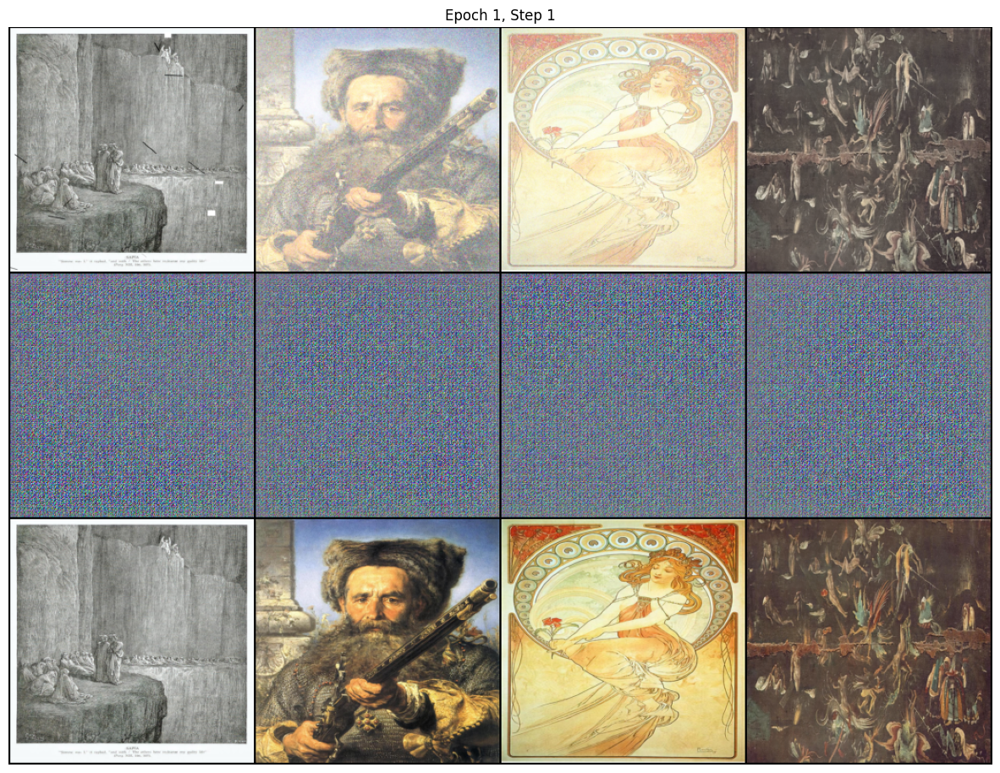

Checkpoint saved at epoch 1, step 1
Epoch [1/2], Step [101/20361], D_Loss: 0.2489, G_Loss: 4.3641, Time: 75.15s
Epoch [1/2], Step [201/20361], D_Loss: 0.4970, G_Loss: 2.8242, Time: 145.20s
Epoch [1/2], Step [301/20361], D_Loss: 0.1172, G_Loss: 3.2167, Time: 214.90s
Epoch [1/2], Step [401/20361], D_Loss: 0.0595, G_Loss: 4.7478, Time: 284.25s
Epoch [1/2], Step [501/20361], D_Loss: 0.1872, G_Loss: 4.3357, Time: 353.62s


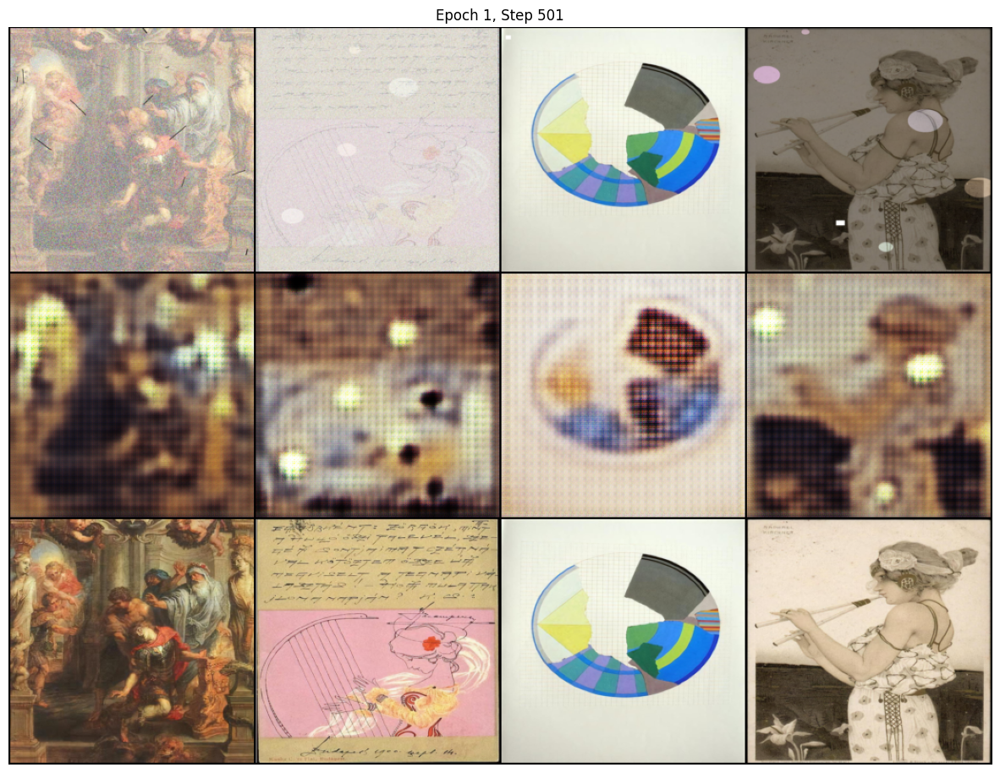

Checkpoint saved at epoch 1, step 501
Epoch [1/2], Step [601/20361], D_Loss: 0.1178, G_Loss: 3.5796, Time: 429.74s
Epoch [1/2], Step [701/20361], D_Loss: 0.1588, G_Loss: 2.9985, Time: 499.29s
Epoch [1/2], Step [801/20361], D_Loss: 0.0260, G_Loss: 4.2899, Time: 569.16s
Epoch [1/2], Step [901/20361], D_Loss: 0.1038, G_Loss: 3.0270, Time: 639.17s
Epoch [1/2], Step [1001/20361], D_Loss: 0.0363, G_Loss: 3.2377, Time: 708.52s


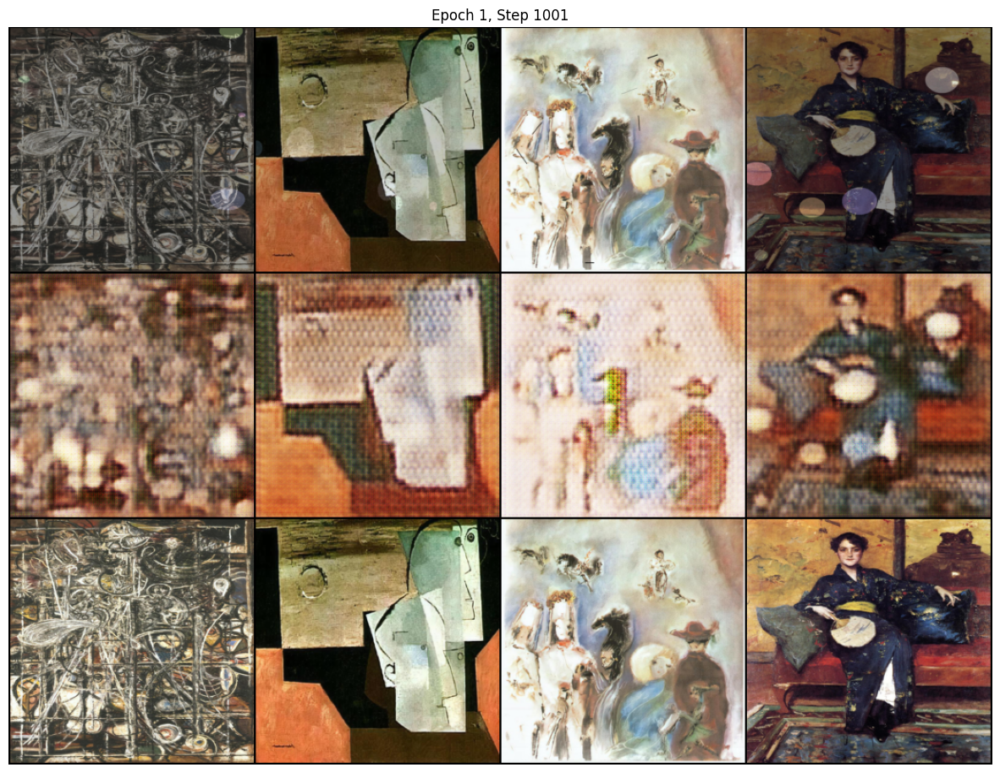

Checkpoint saved at epoch 1, step 1001
Epoch [1/2], Step [1101/20361], D_Loss: 0.0510, G_Loss: 3.0687, Time: 785.18s
Epoch [1/2], Step [1201/20361], D_Loss: 0.1120, G_Loss: 2.5614, Time: 855.90s
Epoch [1/2], Step [1301/20361], D_Loss: 0.0310, G_Loss: 3.4933, Time: 926.09s
Epoch [1/2], Step [1401/20361], D_Loss: 0.0169, G_Loss: 2.9444, Time: 995.75s
Epoch [1/2], Step [1501/20361], D_Loss: 0.0335, G_Loss: 2.9482, Time: 1065.85s


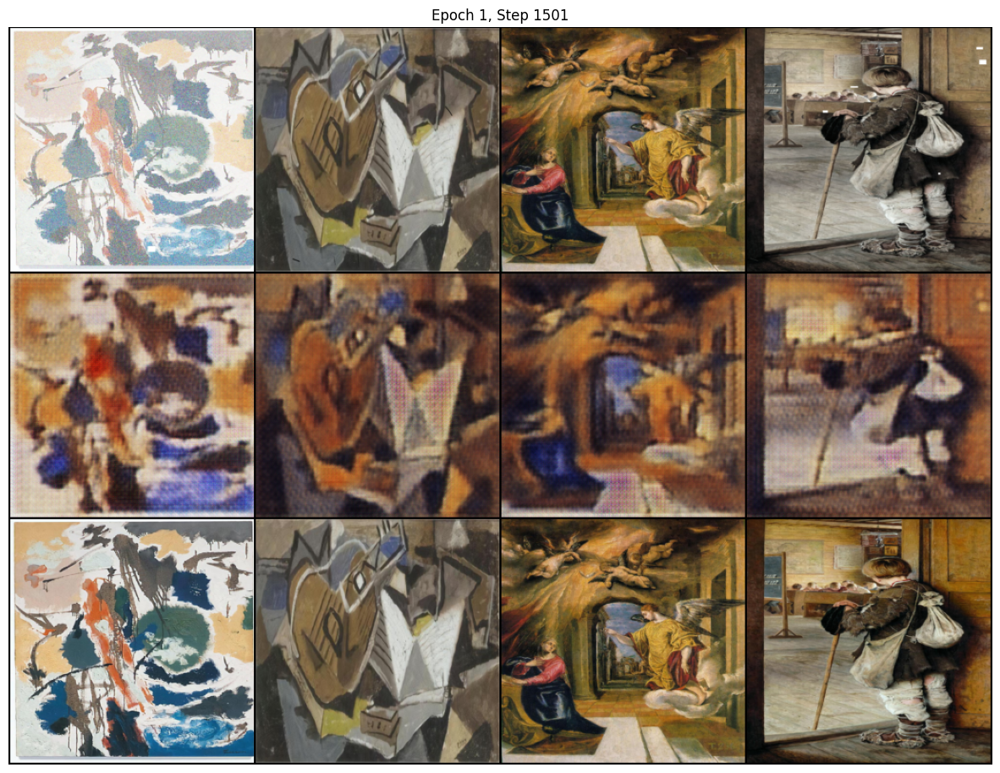

Checkpoint saved at epoch 1, step 1501
Epoch [1/2], Step [1601/20361], D_Loss: 0.0117, G_Loss: 2.7253, Time: 1142.34s
Epoch [1/2], Step [1701/20361], D_Loss: 0.0433, G_Loss: 3.0743, Time: 1212.64s
Epoch [1/2], Step [1801/20361], D_Loss: 0.1115, G_Loss: 4.7418, Time: 1282.24s
Epoch [1/2], Step [1901/20361], D_Loss: 0.0592, G_Loss: 2.3897, Time: 1351.88s
Epoch [1/2], Step [2001/20361], D_Loss: 0.0228, G_Loss: 3.3783, Time: 1421.87s


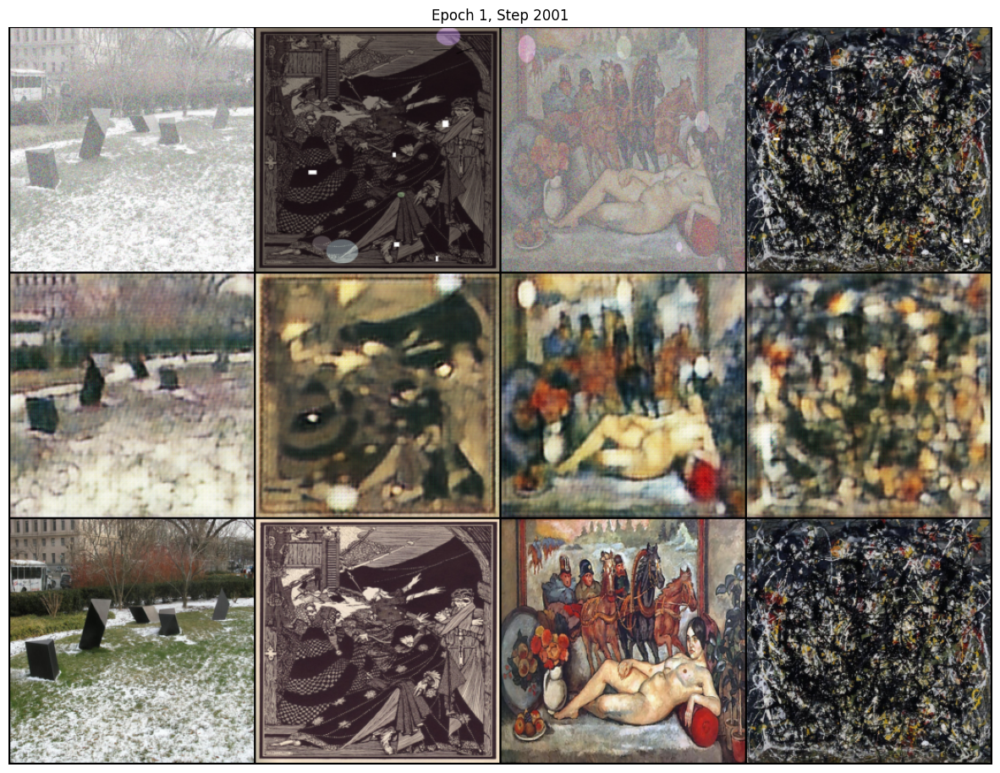

Checkpoint saved at epoch 1, step 2001
Epoch [1/2], Step [2101/20361], D_Loss: 0.0122, G_Loss: 3.3007, Time: 1498.59s
Epoch [1/2], Step [2201/20361], D_Loss: 0.1655, G_Loss: 3.0330, Time: 1568.38s
Epoch [1/2], Step [2301/20361], D_Loss: 0.0207, G_Loss: 3.2899, Time: 1638.00s
Epoch [1/2], Step [2401/20361], D_Loss: 0.0298, G_Loss: 2.8281, Time: 1708.28s
Epoch [1/2], Step [2501/20361], D_Loss: 0.0358, G_Loss: 2.2854, Time: 1778.41s


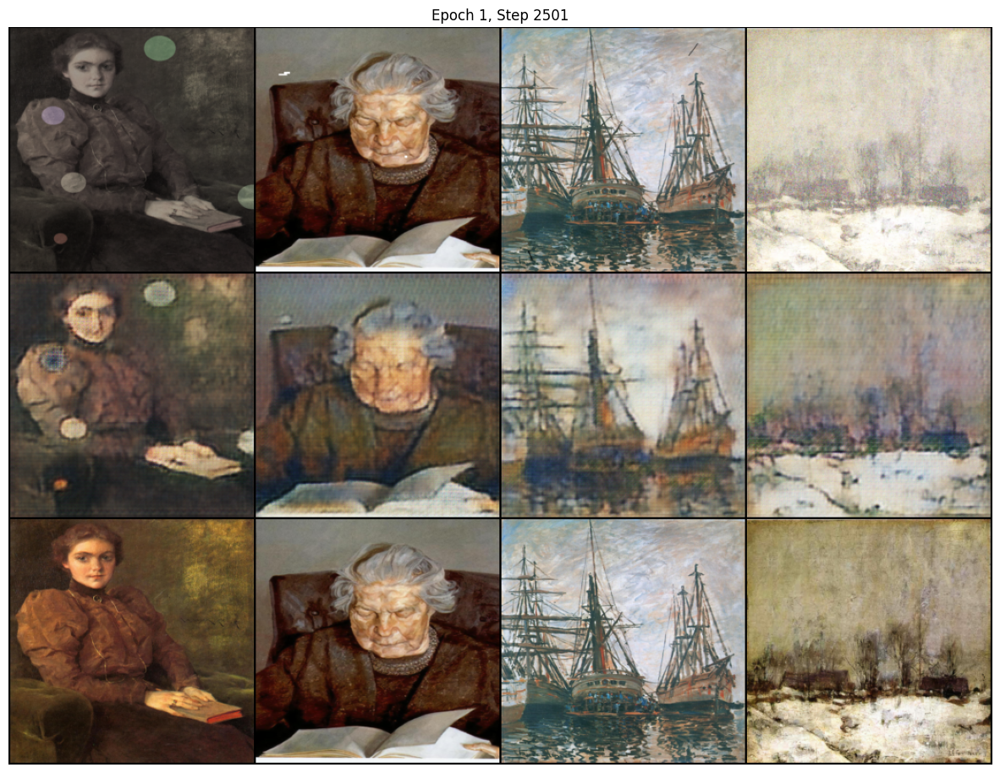

Checkpoint saved at epoch 1, step 2501
Epoch [1/2], Step [2601/20361], D_Loss: 0.1421, G_Loss: 2.0208, Time: 1854.98s
Epoch [1/2], Step [2701/20361], D_Loss: 0.0163, G_Loss: 2.6298, Time: 1925.23s
Epoch [1/2], Step [2801/20361], D_Loss: 0.0110, G_Loss: 2.7276, Time: 1995.19s
Epoch [1/2], Step [2901/20361], D_Loss: 0.0931, G_Loss: 2.9245, Time: 2065.24s
Epoch [1/2], Step [3001/20361], D_Loss: 0.0589, G_Loss: 3.6044, Time: 2135.36s


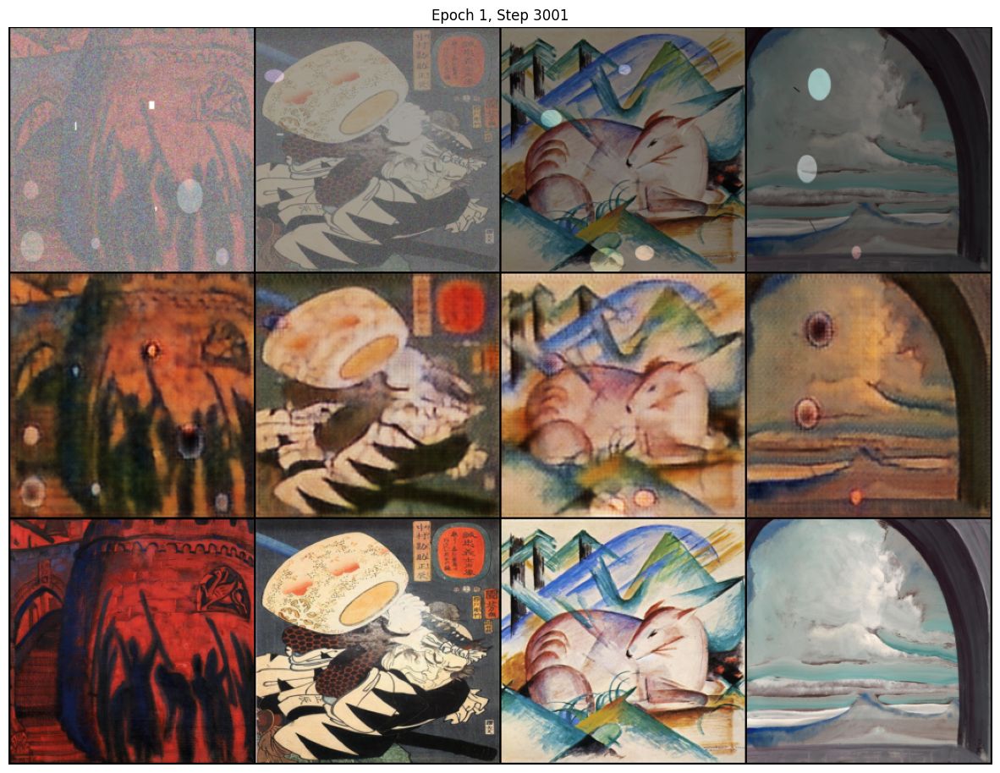

Checkpoint saved at epoch 1, step 3001
Epoch [1/2], Step [3101/20361], D_Loss: 0.0246, G_Loss: 2.9708, Time: 2212.39s
Epoch [1/2], Step [3201/20361], D_Loss: 0.0451, G_Loss: 3.2475, Time: 2282.15s
Epoch [1/2], Step [3301/20361], D_Loss: 0.0322, G_Loss: 2.4779, Time: 2351.93s
Epoch [1/2], Step [3401/20361], D_Loss: 0.0370, G_Loss: 2.2154, Time: 2422.16s
Epoch [1/2], Step [3501/20361], D_Loss: 0.0788, G_Loss: 2.7732, Time: 2492.24s


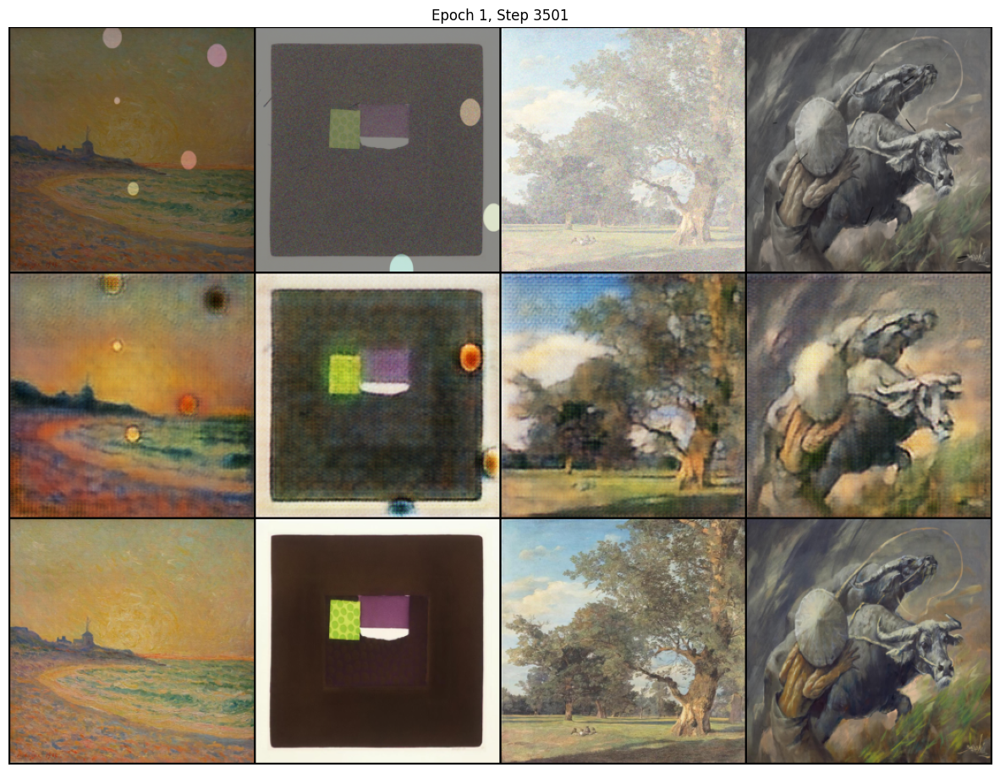

Checkpoint saved at epoch 1, step 3501
Epoch [1/2], Step [3601/20361], D_Loss: 0.2825, G_Loss: 3.0367, Time: 2567.94s
Epoch [1/2], Step [3701/20361], D_Loss: 0.0278, G_Loss: 2.6326, Time: 2637.20s
Epoch [1/2], Step [3801/20361], D_Loss: 0.0052, G_Loss: 2.4040, Time: 2706.23s
Epoch [1/2], Step [3901/20361], D_Loss: 0.0514, G_Loss: 2.7024, Time: 2775.75s
Epoch [2/2], Step [1/20361], D_Loss: 0.0071, G_Loss: 2.5938, Time: 1.81s


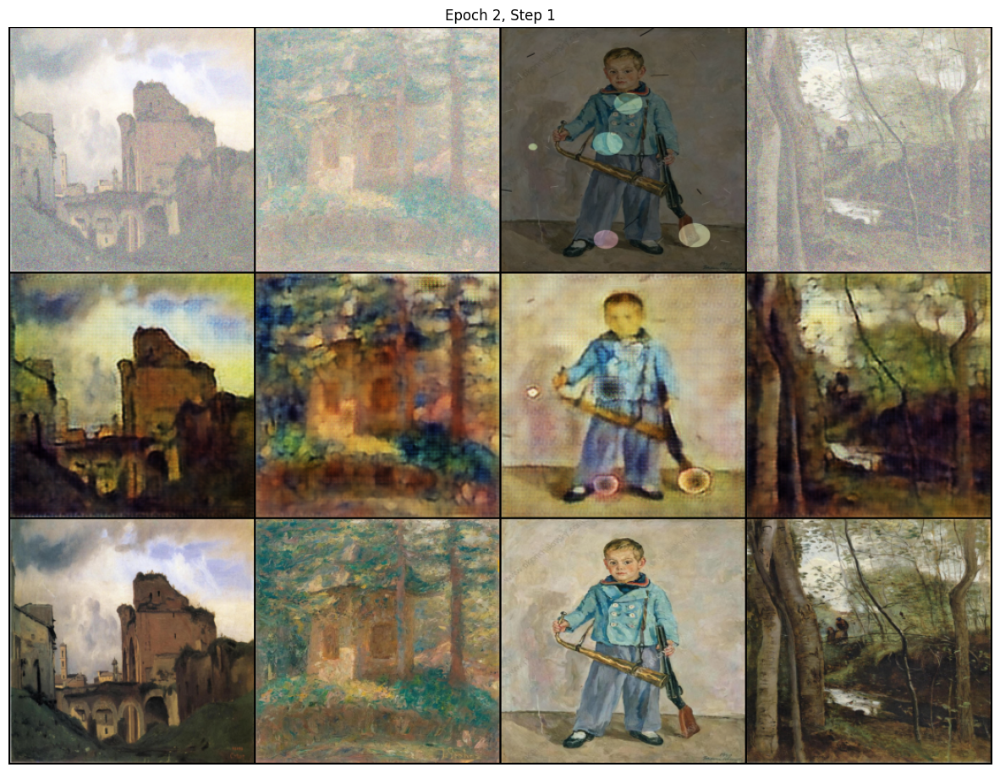

Checkpoint saved at epoch 2, step 1
Epoch [2/2], Step [101/20361], D_Loss: 0.0174, G_Loss: 2.4320, Time: 79.09s
Epoch [2/2], Step [201/20361], D_Loss: 0.0427, G_Loss: 2.1676, Time: 148.82s
Epoch [2/2], Step [301/20361], D_Loss: 0.0962, G_Loss: 2.5603, Time: 218.47s
Epoch [2/2], Step [401/20361], D_Loss: 0.0106, G_Loss: 2.6539, Time: 288.18s
Epoch [2/2], Step [501/20361], D_Loss: 0.0199, G_Loss: 2.8692, Time: 358.35s


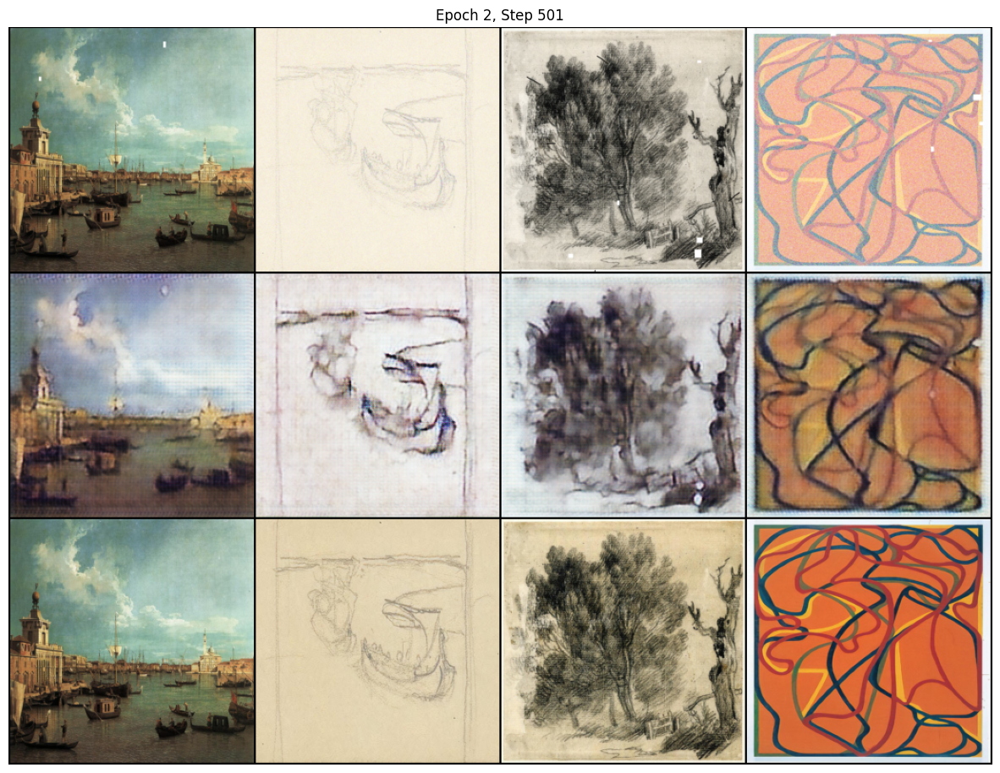

Checkpoint saved at epoch 2, step 501
Epoch [2/2], Step [601/20361], D_Loss: 0.0074, G_Loss: 2.6595, Time: 434.04s
Epoch [2/2], Step [701/20361], D_Loss: 0.0077, G_Loss: 2.9308, Time: 503.32s
Epoch [2/2], Step [801/20361], D_Loss: 0.0121, G_Loss: 2.1608, Time: 573.07s
Epoch [2/2], Step [901/20361], D_Loss: 0.0246, G_Loss: 3.0612, Time: 642.83s
Epoch [2/2], Step [1001/20361], D_Loss: 0.0020, G_Loss: 2.5084, Time: 712.36s


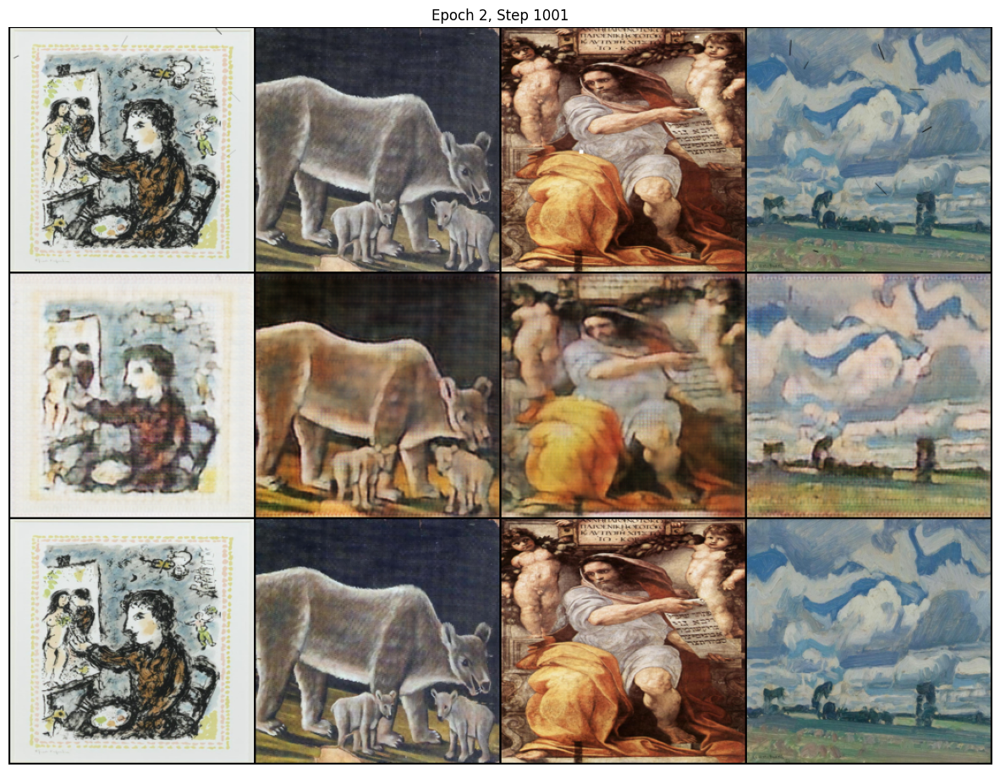

Checkpoint saved at epoch 2, step 1001
Epoch [2/2], Step [1101/20361], D_Loss: 0.0213, G_Loss: 3.3271, Time: 788.86s
Epoch [2/2], Step [1201/20361], D_Loss: 0.1353, G_Loss: 2.7898, Time: 859.69s
Epoch [2/2], Step [1301/20361], D_Loss: 0.0045, G_Loss: 2.6601, Time: 929.69s
Epoch [2/2], Step [1401/20361], D_Loss: 0.0069, G_Loss: 2.8379, Time: 1000.22s
Epoch [2/2], Step [1501/20361], D_Loss: 0.0089, G_Loss: 2.8097, Time: 1070.13s


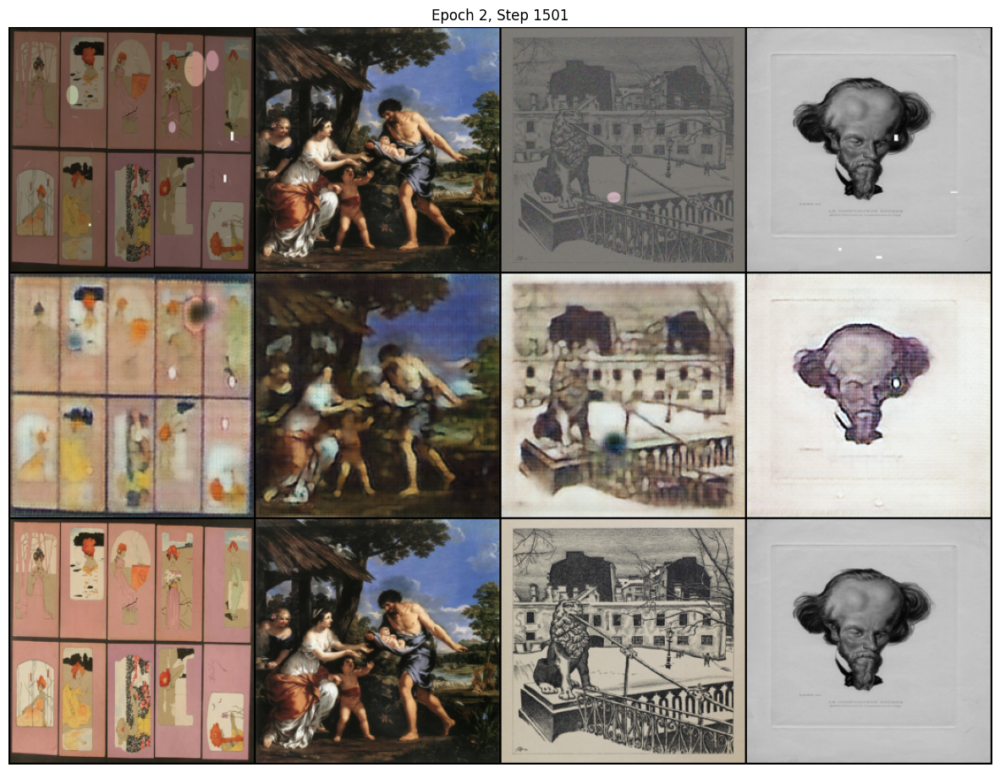

Checkpoint saved at epoch 2, step 1501
Epoch [2/2], Step [1601/20361], D_Loss: 0.0035, G_Loss: 2.5774, Time: 1146.15s
Epoch [2/2], Step [1701/20361], D_Loss: 0.0024, G_Loss: 2.5589, Time: 1215.87s
Epoch [2/2], Step [1801/20361], D_Loss: 0.1921, G_Loss: 1.9483, Time: 1285.71s
Epoch [2/2], Step [1901/20361], D_Loss: 0.0973, G_Loss: 2.3281, Time: 1355.31s
Epoch [2/2], Step [2001/20361], D_Loss: 0.0511, G_Loss: 2.8013, Time: 1425.05s


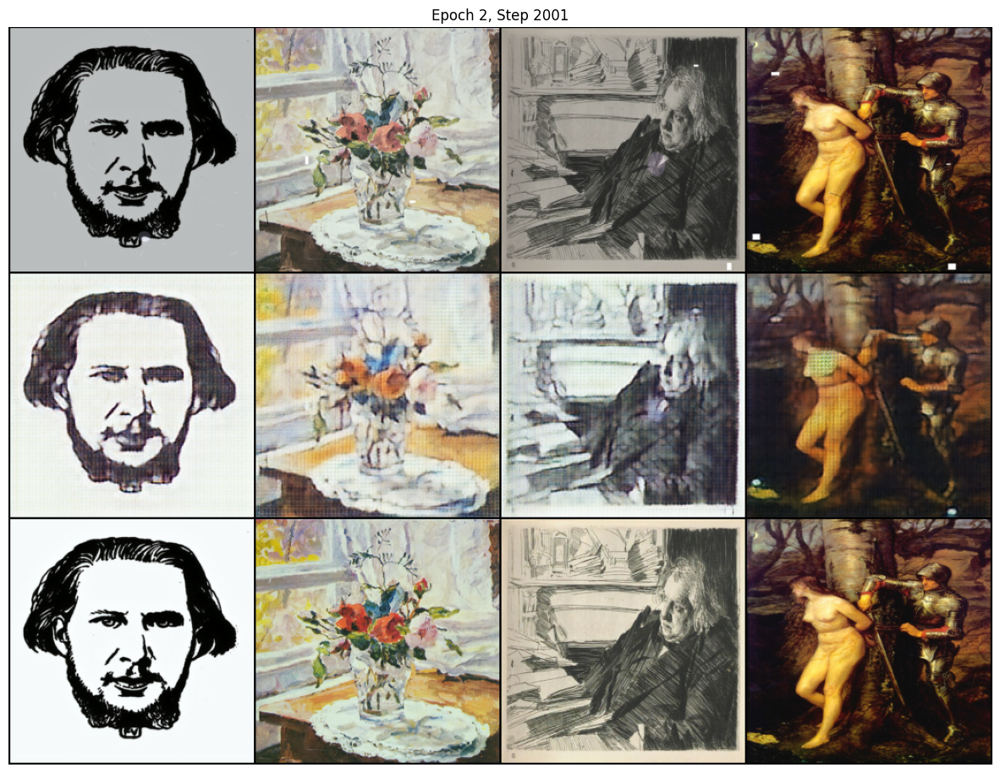

Checkpoint saved at epoch 2, step 2001
Epoch [2/2], Step [2101/20361], D_Loss: 0.1408, G_Loss: 3.0278, Time: 1501.39s
Epoch [2/2], Step [2201/20361], D_Loss: 0.1062, G_Loss: 2.6870, Time: 1571.28s
Epoch [2/2], Step [2301/20361], D_Loss: 0.0117, G_Loss: 2.7771, Time: 1640.62s
Epoch [2/2], Step [2401/20361], D_Loss: 0.0159, G_Loss: 2.4716, Time: 1709.89s
Epoch [2/2], Step [2501/20361], D_Loss: 0.0909, G_Loss: 2.9938, Time: 1779.85s


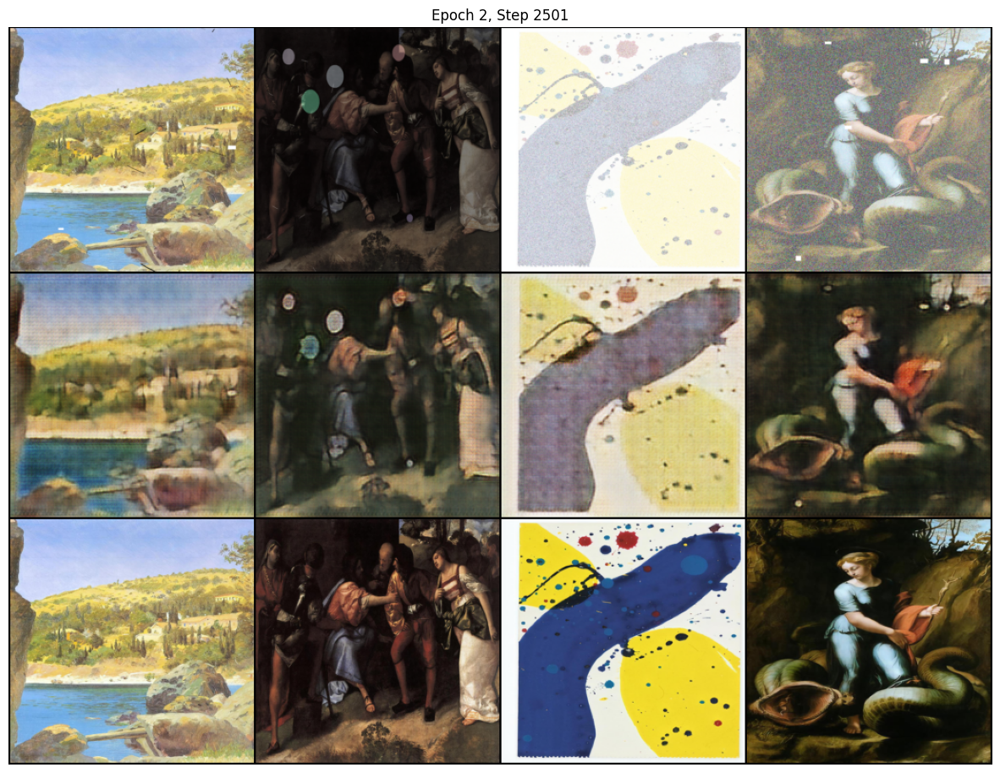

Checkpoint saved at epoch 2, step 2501
Epoch [2/2], Step [2601/20361], D_Loss: 0.0983, G_Loss: 2.9233, Time: 1855.81s
Epoch [2/2], Step [2701/20361], D_Loss: 0.0119, G_Loss: 2.2963, Time: 1925.89s
Epoch [2/2], Step [2801/20361], D_Loss: 0.0108, G_Loss: 2.7162, Time: 1995.44s
Epoch [2/2], Step [2901/20361], D_Loss: 0.0149, G_Loss: 2.2788, Time: 2065.29s
Epoch [2/2], Step [3001/20361], D_Loss: 0.0293, G_Loss: 2.7030, Time: 2135.92s


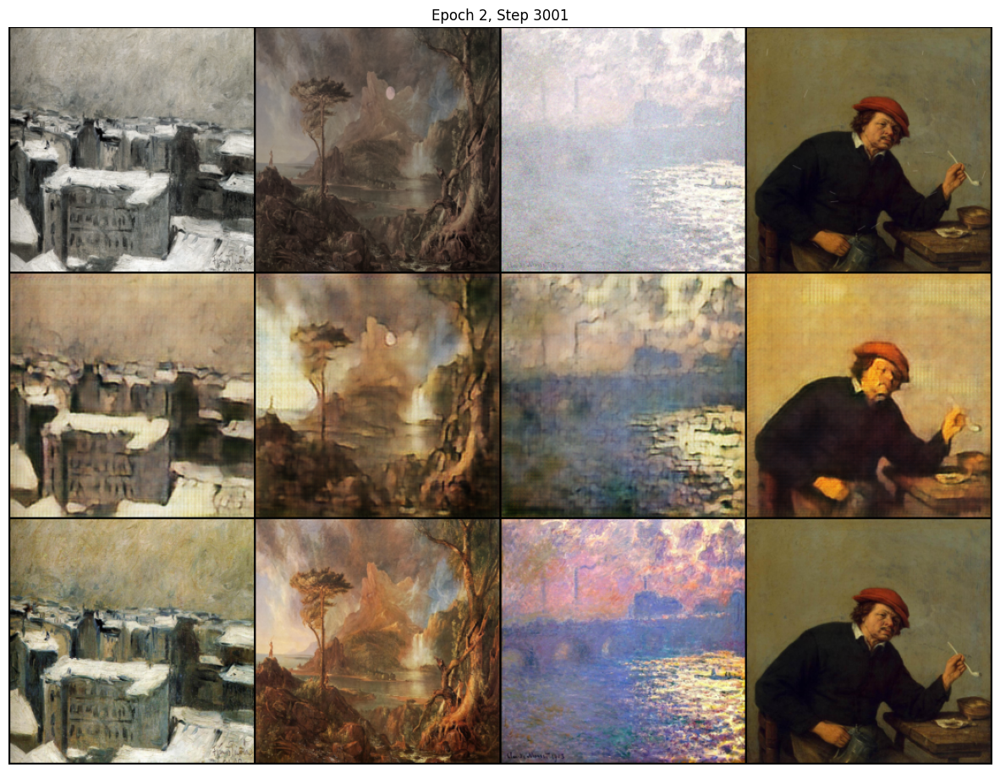

Checkpoint saved at epoch 2, step 3001
Epoch [2/2], Step [3101/20361], D_Loss: 0.0301, G_Loss: 2.7189, Time: 2212.22s
Epoch [2/2], Step [3201/20361], D_Loss: 0.0044, G_Loss: 3.0426, Time: 2282.56s
Epoch [2/2], Step [3301/20361], D_Loss: 0.0572, G_Loss: 3.5152, Time: 2352.82s
Epoch [2/2], Step [3401/20361], D_Loss: 0.0713, G_Loss: 2.6607, Time: 2422.70s
Epoch [2/2], Step [3501/20361], D_Loss: 0.0046, G_Loss: 2.4063, Time: 2493.02s


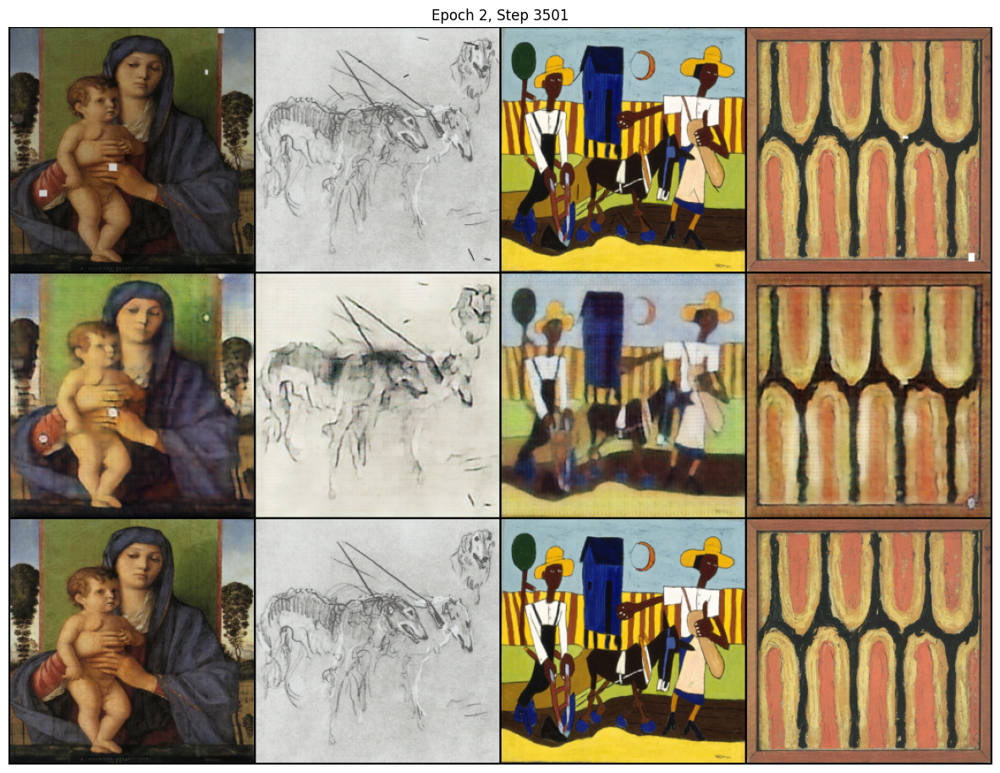

Checkpoint saved at epoch 2, step 3501
Epoch [2/2], Step [3601/20361], D_Loss: 0.0075, G_Loss: 2.8744, Time: 2569.99s
Epoch [2/2], Step [3701/20361], D_Loss: 0.0416, G_Loss: 3.7531, Time: 2640.96s
Epoch [2/2], Step [3801/20361], D_Loss: 0.1679, G_Loss: 2.8279, Time: 2711.14s
Epoch [2/2], Step [3901/20361], D_Loss: 0.0330, G_Loss: 2.1185, Time: 2781.58s
Training completed. Final model saved.


In [16]:
if __name__ == "__main__":
    # Configuration
    config = {
        'data_dir': "../input/wikiart",
        'batch_size': 4,
        'num_workers': 2,
        'num_epochs': 2,
        'lr': 0.0002,
        'lambda_adv': 1.0,
        'lambda_content': 10.0,
        'lambda_style': 1000.0,
        'lambda_tv': 1.0,
        'print_freq': 100,
        'save_freq': 5,
        'max_steps_per_epoch': 4001,
        'scale_factor': 2
    }
    
    # Train model
    train_model(config)

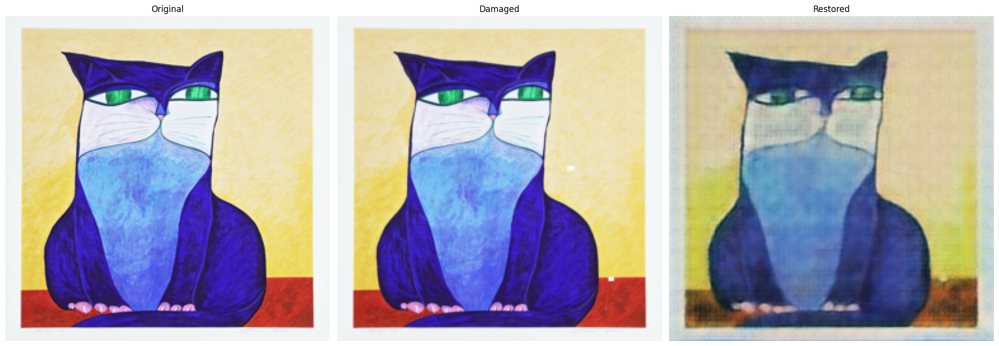

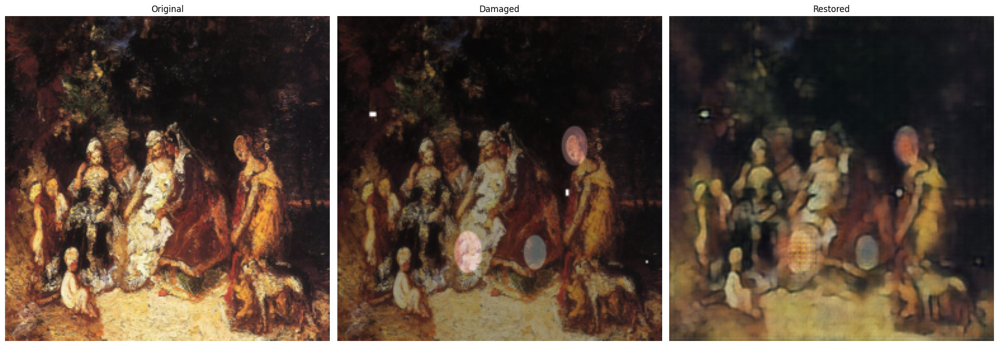

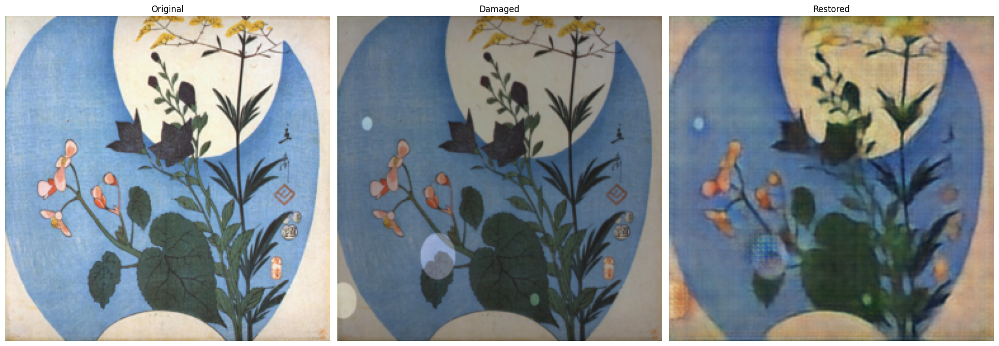

In [17]:
# Test model with sample images
test_images = [
    "../input/wikiart/Naive_Art_Primitivism/aldemir-martins_blue-cat.jpg",
    "../input/wikiart/Romanticism/adolphe-joseph-thomas-monticelli_elegant-women-and-cupids.jpg",
    "../input/wikiart/Ukiyo_e/hiroshige_autumn-flowers-in-front-of-full-moon.jpg"
]

# Check if files exist before testing
existing_images = []
for img_path in test_images:
    if os.path.exists(img_path):
        existing_images.append(img_path)
    else:
        print(f"Warning: {img_path} not found. Skipping.")

if existing_images:
    test_model("artresgan_generator_final.pth", existing_images)
else:
    print("No test images found. Please check the paths.")
